# Preliminaries

## Libraries

In [1]:
%matplotlib inline
from os.path import join
from IPython.core.display import display, HTML
import plotting

import example_utils as utils
import pandas as pd
import os
import numpy as np
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import networkx as nx
import ipywidgets

from shapely.ops import unary_union
import shapely.speedups
from shapely.geometry import Polygon, LineString, Point

# Graphing
import geoplot as gplt
import geoplot.crs as gcrs
import geopandas as gpd


## Hadean Colour scheme

In [2]:
# Hadean colour scheme
hadeanOrange = '#FF9448'
hadeanIndigo = '#27203B'
hadeanCoral = '#FF5C37'
hadeanCopper = '#D66444'
uranianBlue = '#AFDBF5'

In [3]:
def AddTransparency(c,a):
    b = format(max(int(255*a),0),'02X')
    return c+str(b[-2:])

## Chris' Imperial functions

In [4]:
def convert_imperial_network_edges_to_oxford_network_edges(network_data):
    network_data.rename(columns = {'a.index': 'ID_1', 'b.index': 'ID_2'}, inplace=True)
    return network_data

def convert_imperial_node_data_to_oxford_node_data(person_node_data, index_to_label_network_with):
    person_node_data.rename(columns = {'index': 'ID',
                                       'household.index': 'house_no',
                                       'age': 'age_group',
                                       'coord.x': 'x',
                                       'coord.y': 'y'}, inplace=True)

    person_node_data['network_no'] = (np.zeros(len(person_node_data)) + index_to_label_network_with)

    # Convert the age to age group (the decade age group of the person and is an integer between 0 (0-9 years) and 8 (80+).)
    person_node_data['age_group'] = person_node_data['age_group'].apply(lambda x: int(x / 10))

    #print(person_node_data) # CA remove

    return person_node_data

## Coordinate functions

In [5]:
def coord2ll(x,y):
    return np.array([y,x]) * 57.2957795131

def ll2coord(long,lat):
    return np.array([lat,long]) / 57.2957795131

def coord2ll_listIn(x):
    return coord2ll(x[1],x[0])

def ll2coord_list(x):
    return ll2coord(x[1],x[0])


## Load Networks

In [6]:
##########################
# Load Network Functions #
##########################

# Take path of _nodes.csv
def LoadDemographics(demoPath):
    df_household_demographics = pd.read_csv(demoPath, comment="#", sep=",", skipinitialspace=True)
    # Converting we use network_no=0, as that's for household network
    df_household_demographics = convert_imperial_node_data_to_oxford_node_data(df_household_demographics,0)
    return df_household_demographics

def CoordsFromDemo(df_household_demographics):
    df_coordinates = df_household_demographics.rename(columns={'x':'xcoords','y':'ycoords'})[['ID','xcoords','ycoords']]
    return df_coordinates

def LoadOccupationNetworks(projPath, prefix='bristol'):
    ocNetworksArcs_df_dict = {}
    ocNetworksArcs_colNames = ['ID_1','a.x','a.y','ID_2','b.x','b.y']
    network_name = np.array(['primary', 'secondary', 'general_workforce', 'retired', 'elderly'])

    # Can find network assignment by the a.index for each _i_arcs.csv
    for i,x in enumerate(tqdm(network_name)):
        print([i,x])
        ocNetworksArcs_df_dict[x] = pd.read_csv(projPath+'/'+prefix+"_"+str(i)+"_arcs.csv", comment="#", sep=",", skipinitialspace=True)
        ocNetworksArcs_df_dict[x].columns = ocNetworksArcs_colNames
    
    return ocNetworksArcs_df_dict

###################
# Parameter stuff #
###################

def LoadParams(df_household_demographics, params=None):
    if params == None:
        params = utils.get_baseline_parameters()
    n_total = len(df_household_demographics["ID"])
    params.set_param("n_total", n_total)
    params.set_demographic_household_table(df_household_demographics)
    return params

def LoadNetworks(model, ocNetworksArcs_df_dict, daily_fraction=0.5):
    for i,net in enumerate(ocNetworksArcs_df_dict):
        model.delete_network(model.get_network_by_id(i+2))
        model.add_user_network(ocNetworksArcs_df_dict[net], name=net, daily_fraction=daily_fraction)

def ImperialNetwork1(netPath,n_infect=10,prefix='bristol'):
    df_household_demographics = LoadDemographics(netPath+'/'+prefix+'_0_nodes.csv')
    df_coordinates = CoordsFromDemo(df_household_demographics)
    ocNetworksArcs_df_dict = LoadOccupationNetworks(netPath)
    params = LoadParams(df_household_demographics)
    params.set_param("n_seed_infection",n_infect)
    
#     # Mods
#     params.set_param("fatality_fraction_0_9", 0.33/2)
#     params.set_param("fatality_fraction_10_19", 0.25/2)
#     params.set_param("fatality_fraction_20_29", 0.50/2)
#     params.set_param("fatality_fraction_30_39", 0.50/2)
#     params.set_param("fatality_fraction_40_49", 0.50/2)
#     params.set_param("fatality_fraction_50_59", 0.69/2)
#     params.set_param("fatality_fraction_60_69", 0.65/2)
#     params.set_param("fatality_fraction_70_79", 0.88/2)
#     params.set_param("fatality_fraction_80", 1.00/2)
    
#     params.set_param("mean_time_to_death", 15.85)
#     params.set_param("sd_time_to_death", 6.59)
    
#     # End Mods

    model = utils.get_simulation( params ).env.model
    model.assign_coordinates_individuals(df_coordinates)
    LoadNetworks(model, ocNetworksArcs_df_dict)
    return model

def ImperialNetwork2(netPath,n_infect=10,prefix='bristol'):
    df_household_demographics = LoadDemographics(netPath+'/'+prefix+'_0_nodes.csv')
    df_coordinates = CoordsFromDemo(df_household_demographics)
    ocNetworksArcs_df_dict = LoadOccupationNetworks(netPath)
    params = LoadParams(df_household_demographics)
    params.set_param("n_seed_infection",n_infect)
    
#     # Mods
#     params.set_param("fatality_fraction_0_9", 0.33/2)
#     params.set_param("fatality_fraction_10_19", 0.25/2)
#     params.set_param("fatality_fraction_20_29", 0.50/2)
#     params.set_param("fatality_fraction_30_39", 0.50/2)
#     params.set_param("fatality_fraction_40_49", 0.50/2)
#     params.set_param("fatality_fraction_50_59", 0.69/2)
#     params.set_param("fatality_fraction_60_69", 0.65/2)
#     params.set_param("fatality_fraction_70_79", 0.88/2)
#     params.set_param("fatality_fraction_80", 1.00/2)
    
#     params.set_param("mean_time_to_death", 15.85)
#     params.set_param("sd_time_to_death", 6.59)
    
#     # End Mods

    model = utils.get_simulation( params ).env.model
    model.assign_coordinates_individuals(df_coordinates)
    LoadNetworks(model, ocNetworksArcs_df_dict)
    return model

# Lockdown Functions

In [7]:
def RadiusIndividual(model,target,r,d=np.linalg.norm):
    x = model.get_individuals()
    x['d'] = d(x[['xcoords','ycoords']]-target,axis=1)
    x = x.loc[x['d']<=r]
    return list(x['ID'])

def LockdownInRadius(model, target, r, n=14):
    indivs = model.get_individuals()
    indivs = RadiusIndividual(model,target,r)
    t = model.one_time_step_results()['time']
    for i in indivs:
        model.intervention_quarantine_until_by_idx(i,0,t+n,0)

# def ProperLockdown(model, target, n=14):
#     indivs = model.get_individuals()
#     indivs = indivs['ID']
#     t = model.one_time_step_results()['time']
#     for i in indivs:
#         model.intervention_quarantine_until_by_idx(i, 0, t+n, 0)

# def LockdownLite(model, target, n=14):
#     indivs = model.get_individuals()
#     indivs = indivs['ID']
#     t = model.one_time_step_results()['time']
#     for i in range(0, len(indivs), 2):
#         model.intervention_quarantine_until_by_idx(i, 0, t+n, 0)


In [8]:
def Infected(model):
    statuses2Track = [1,2,3,4,5,6,7,8,20] # In model.py, v. difficult to find
    statuses2Track = [4,5]

    x = model.get_individuals()
    x = x.loc[x['current_status'].isin(statuses2Track)]
    return list(x['ID'])

# scarrily current_status does not seem to change when quarantined
def Lockdowned(model):
    x = model.get_individuals()
    x = x.loc[x['quarantined'] == 1]
    return list(x['ID'])

# Visualise Network and RunSim Functions

In [9]:
def VisualiseNetwork(model, ax, aNode = 1/2**7, aEdge = 1/2**7):
    # Correct function!
    nodes = model.get_individuals()
    nodes_pos = {nodes['ID'][i]:[nodes['xcoords'][i],nodes['ycoords'][i]] for i in range(len(nodes))}
    infected = Infected(model)
    quarantined = Lockdowned(model)
    g = nx.Graph()
    #g = nx.from_pandas_edgelist(ocNetworksArcs_df_dict['primary'],'ID_1','ID_2',create_using=nx.Graph())
    g.add_nodes_from(nodes['ID'])
    g_infected = nx.subgraph(g,infected)
    g_quarantined = nx.subgraph(g,quarantined)
    #f,ax = plt.subplots(figsize=(20,10))
    nx.draw(g,pos=nodes_pos,node_size=5,edge_color=AddTransparency(hadeanOrange,aEdge),node_color=AddTransparency(hadeanIndigo,aNode),ax=ax)
    nx.draw_networkx_nodes(g_quarantined,pos=nodes_pos,node_size=5,node_color=AddTransparency(uranianBlue,0.02),ax=ax)
    nx.draw_networkx_nodes(g_infected,pos=nodes_pos,node_size=5,node_color=AddTransparency(hadeanOrange,0.9),ax=ax)

In [10]:
bristol_net_dir = "../../id_spatial_sim/scenarios/bristol/output/networks"
mdm_net_dir = "../../id_spatial_sim/scenarios/mdm3_scenario/output/networks"


aNode = 1/2**7
aEdge = 1/2**7

bristol_gif_out = '../../NetworkData/bristol/'
mdm_gif_out = '../../NetworkData/mdm/'
gif_out = '../../NetworkData/'

In [11]:
from matplotlib.lines import Line2D

# Run several time-steps and produce many PNGs to be converted to a GIF
def RunSim_WithPlot(model, out_dir=gif_out, n=64, title_text='Spread of COVID-19 on an artificial network of Bristol'):
    for i in tqdm(range(n)):
        f,ax = plt.subplots(figsize=(20,10))
        t = model.one_time_step_results()['time']
        VisualiseNetwork(model,ax)
        plt.title(title_text,fontsize=32)
        agentPatch = Line2D([0],[0],marker='o',linestyle='none',color=AddTransparency(hadeanIndigo,aNode),label='Agent')
        conPatch = Line2D([0],[0],marker='o',linestyle='none',color=AddTransparency(hadeanOrange,0.9),label='Contagious')
        lg1 = plt.legend(handles=[agentPatch,conPatch],fontsize=16)
        text = "Time = "+"{:04d}".format(t)
        textPatch = Line2D([0],[0],linestyle='none',label=text)
        ax.legend(handles=[textPatch],loc='lower left',frameon=False)
        ax.add_artist(lg1)
        print(out_dir+"{:04d}".format(t)+'.png')
        f.savefig(out_dir+"{:04d}".format(t)+'.png')
        model.one_time_step()
        ax.clear()
        plt.clf()
    
# Then use a `convert ./out_dir/*.png ./net.gif` from terminal

In [12]:
# Just run several time-steps
def RunSim_NoPlot(model, n=64, out_dir=gif_out):
    for i in tqdm(range(n)):
        f,ax = plt.subplots(figsize=(20,10))
        t = model.one_time_step_results()['time']
        agentPatch = Line2D([0],[0],marker='o',linestyle='none',color=AddTransparency(hadeanIndigo,aNode),label='Agent')
        conPatch = Line2D([0],[0],marker='o',linestyle='none',color=AddTransparency(hadeanOrange,0.9),label='Contagious')
        lg1 = plt.legend(handles=[agentPatch,conPatch],fontsize=16)
        text = "Time = "+"{:04d}".format(t)
        textPatch = Line2D([0],[0],linestyle='none',label=text)
        ax.legend(handles=[textPatch],loc='lower left',frameon=False)
        ax.add_artist(lg1)
        print(out_dir+"{:04d}".format(t)+'.png')
        model.one_time_step()
        ax.clear()
        plt.clf()
#     for i in tqdm(range(n)):
#         t = model.one_time_step_results()['time']
#         print("Generated Day: " + "{:04d}".format(t))
#         model.one_time_step()

# Seeding

In [13]:
# replace bc4 with the coords of your desired location
long,lat = coord2ll(1.0,-.1)
x,y = ll2coord(long,lat)

# ASSL coords
bc4 = [51.45951819, -2.60148918]
bc4_x, bc4_y = ll2coord(bc4[0],bc4[1])
bc4_xy = np.array([bc4_x,bc4_y])
# print([bc4_x, bc4_y])

In [14]:
## Bristol
bristol_model = ImperialNetwork1(bristol_net_dir)
bristol_df_indiv = bristol_model.get_individuals()
print("\nBristol model generated. \n")

  0%|          | 0/5 [00:00<?, ?it/s]

[0, 'primary']
[1, 'secondary']
[2, 'general_workforce']
[3, 'retired']
[4, 'elderly']

Bristol model generated. 



In [15]:
## MDM
mdm_model = ImperialNetwork1(bristol_net_dir)
mdm_df_indiv = mdm_model.get_individuals()
print("\nMDM model generated. \n")

  0%|          | 0/5 [00:00<?, ?it/s]

[0, 'primary']
[1, 'secondary']
[2, 'general_workforce']
[3, 'retired']
[4, 'elderly']

MDM model generated. 



In [16]:
d = np.linalg.norm
bristol_df_indiv['d'] = d(bristol_df_indiv[['xcoords','ycoords']]-bc4_xy,axis=1)
mdm_df_indiv['d'] = d(mdm_df_indiv[['xcoords','ycoords']]-bc4_xy,axis=1)

bristol_mind = bristol_df_indiv['d'].idxmin()
bristol_bc4_house = int(bristol_df_indiv.iloc[bristol_mind]['house_no'])
mdm_mind = mdm_df_indiv['d'].idxmin()
mdm_bc4_house = int(mdm_df_indiv.iloc[mdm_mind]['house_no'])

coord2ll(bristol_df_indiv.iloc[bristol_mind]['xcoords'],bristol_df_indiv.iloc[bristol_mind]['ycoords'])
coord2ll(mdm_df_indiv.iloc[mdm_mind]['xcoords'],mdm_df_indiv.iloc[mdm_mind]['ycoords'])

# bristol_df_indiv.loc[bristol_df_indiv['house_no']==bristol_bc4_house]
# mdm_df_indiv.loc[mdm_df_indiv['house_no']==mdm_bc4_house]

bristol_bc4_indivs = [x for x in list(bristol_df_indiv.loc[bristol_df_indiv['house_no']==bristol_bc4_house]['ID'])]
mdm_bc4_indivs = [x for x in list(mdm_df_indiv.loc[mdm_df_indiv['house_no']==mdm_bc4_house]['ID'])]

for i in bristol_bc4_indivs:
    bristol_model.seed_infect_by_idx(i)
    
for i in mdm_bc4_indivs:
    mdm_model.seed_infect_by_idx(i)

In [47]:
# ## BRISTOL
# # replace bc4 with the coords of your desired location
# long,lat = coord2ll(1.0,-.1)
# x,y = ll2coord(long,lat)

# # ASSL coords
# bc4 = [51.45951819, -2.60148918]
# bc4_x, bc4_y = ll2coord(bc4[0],bc4[1])
# bc4_xy = np.array([bc4_x,bc4_y])
# # print([bc4_x, bc4_y])

# bristol_model = ImperialNetwork(bristol_net_dir)
# bristol_df_indiv = bristol_model.get_individuals()
# print("\nBristol model generated. \n")

# d = np.linalg.norm
# bristol_df_indiv['d'] = d(bristol_df_indiv[['xcoords','ycoords']]-bc4_xy,axis=1)

# bristol_mind = bristol_df_indiv['d'].idxmin()
# bristol_bc4_house = int(bristol_df_indiv.iloc[bristol_mind]['house_no'])
# # print(bristol_df_indiv.iloc[bristol_mind])
# # print(coord2ll(bristol_df_indiv.iloc[bristol_mind]['xcoords'],bristol_df_indiv.iloc[bristol_mind]['ycoords']))

# coord2ll(bristol_df_indiv.iloc[bristol_mind]['xcoords'],bristol_df_indiv.iloc[bristol_mind]['ycoords'])
# # bristol_df_indiv.loc[bristol_df_indiv['house_no']==bristol_bc4_house]
# bristol_bc4_indivs = [x for x in list(bristol_df_indiv.loc[bristol_df_indiv['house_no']==bristol_bc4_house]['ID'])]

# for i in bristol_bc4_indivs:
#     bristol_model.seed_infect_by_idx(i)

In [48]:
print(bristol_model.get_param("fatality_fraction_0_9"))
print(mdm_model.get_param("fatality_fraction_0_9"))

0.33
0.33


# Run the Simulation

In [19]:
# Lockdowned(bristol_model)
# RadiusIndividual(bristol_model,bc4_xy,.00001)
ev = [51.44930383152205, -2.619099290387059]
r2halfkm = np.linalg.norm(np.array(ll2coord(bc4[0],bc4[1]))-np.array(ll2coord(ev[0],ev[1]))) #3.5km


# 30 = 27 days plus 10 day incub. per
# # LockdownInRadius(bristol_model, bc4_xy, r2halfkm*300, n=52)
RunSim_NoPlot(bristol_model, n = 100, out_dir=gif_out)



# # # 37 = 27 days plus 10 day incub. period
RunSim_NoPlot(mdm_model, n = 100, out_dir=gif_out)



## ONES FOR REPORT

# RunSim_WithPlot(bristol_model,n=29, out_dir=bristol_gif_out)
# # LockdownInRadius(bristol_model, bc4_xy, r2halfkm*30, n=52)
# # RunSim_WithPlot(bristol_model,n=75, out_dir=bristol_gif_out)

# RunSim_WithPlot(mdm_model,n = 29, out_dir=mdm_gif_out)
# # LockdownInRadius(mdm_model, bc4_xy, r2halfkm*30, n=52)
# # RunSim_WithPlot(mdm_model,n = 75, out_dir=mdm_gif_out)


  0%|          | 0/100 [00:00<?, ?it/s]

../../NetworkData/0000.png
../../NetworkData/0001.png
../../NetworkData/0002.png
../../NetworkData/0003.png
../../NetworkData/0004.png
../../NetworkData/0005.png
../../NetworkData/0006.png
../../NetworkData/0007.png
../../NetworkData/0008.png
../../NetworkData/0009.png
../../NetworkData/0010.png
../../NetworkData/0011.png
../../NetworkData/0012.png
../../NetworkData/0013.png
../../NetworkData/0014.png
../../NetworkData/0015.png
../../NetworkData/0016.png
../../NetworkData/0017.png
../../NetworkData/0018.png
../../NetworkData/0019.png
../../NetworkData/0020.png


/tmp/ipykernel_63/2248709254.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f,ax = plt.subplots(figsize=(20,10))


../../NetworkData/0021.png
../../NetworkData/0022.png
../../NetworkData/0023.png
../../NetworkData/0024.png
../../NetworkData/0025.png
../../NetworkData/0026.png
../../NetworkData/0027.png
../../NetworkData/0028.png
../../NetworkData/0029.png
../../NetworkData/0030.png
../../NetworkData/0031.png
../../NetworkData/0032.png
../../NetworkData/0033.png
../../NetworkData/0034.png
../../NetworkData/0035.png
../../NetworkData/0036.png
../../NetworkData/0037.png
../../NetworkData/0038.png
../../NetworkData/0039.png
../../NetworkData/0040.png
../../NetworkData/0041.png
../../NetworkData/0042.png
../../NetworkData/0043.png
../../NetworkData/0044.png
../../NetworkData/0045.png
../../NetworkData/0046.png
../../NetworkData/0047.png
../../NetworkData/0048.png
../../NetworkData/0049.png
../../NetworkData/0050.png
../../NetworkData/0051.png
../../NetworkData/0052.png
../../NetworkData/0053.png
../../NetworkData/0054.png
../../NetworkData/0055.png
../../NetworkData/0056.png
../../NetworkData/0057.png
.

  0%|          | 0/100 [00:00<?, ?it/s]

../../NetworkData/0000.png
../../NetworkData/0001.png
../../NetworkData/0002.png
../../NetworkData/0003.png
../../NetworkData/0004.png
../../NetworkData/0005.png
../../NetworkData/0006.png
../../NetworkData/0007.png
../../NetworkData/0008.png
../../NetworkData/0009.png
../../NetworkData/0010.png
../../NetworkData/0011.png
../../NetworkData/0012.png
../../NetworkData/0013.png
../../NetworkData/0014.png
../../NetworkData/0015.png
../../NetworkData/0016.png
../../NetworkData/0017.png
../../NetworkData/0018.png
../../NetworkData/0019.png
../../NetworkData/0020.png
../../NetworkData/0021.png
../../NetworkData/0022.png
../../NetworkData/0023.png
../../NetworkData/0024.png
../../NetworkData/0025.png
../../NetworkData/0026.png
../../NetworkData/0027.png
../../NetworkData/0028.png
../../NetworkData/0029.png
../../NetworkData/0030.png
../../NetworkData/0031.png
../../NetworkData/0032.png
../../NetworkData/0033.png
../../NetworkData/0034.png
../../NetworkData/0035.png
../../NetworkData/0036.png
.

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

In [94]:
# RunSim_NoPlot(bristol_model, n=27)
# RunSim_NoPlot(mdm_model, n=27)

In [20]:
#####################
# Crispian's Mods 1 #
#####################

## Write bristol output files
bristol_df_timeseries = pd.DataFrame(bristol_model.results)
# bristol_df_timeseries1.to_csv('bristol_df_timeseries1.csv', encoding='utf-8')

# bristol_model.write_output_files()
# # Rename and move bristol output files into subfolder
# os.rename("individual_file_Run11.csv", "./output_files/bristol_individual_file_Run11.csv")
# os.rename("interactions_Run11.csv", "./output_files/bristol_interactions_Run11.csv")
# os.rename("trace_tokens_Run11.csv", "./output_files/bristol_trace_tokens_Run11.csv")
# os.rename("transmission_Run11.csv", "./output_files/bristol_transmission_Run11.csv")

In [21]:
#####################
# Crispian's Mods 2 #
#####################
## Write mdm3 output files
mdm_df_timeseries = pd.DataFrame(mdm_model.results)
# mdm_df_timeseries.to_csv('mdm_df_timeseries.csv', encoding='utf-8')

# mdm_model.write_output_files()
# # Rename and move mdm3 output files into subfolder
# os.rename("individual_file_Run1.csv", "./output_files/mdm_individual_file_Run1.csv")
# os.rename("interactions_Run1.csv", "./output_files/mdm_interactions_Run1.csv")
# os.rename("trace_tokens_Run1.csv", "./output_files/mdm_trace_tokens_Run1.csv")
# os.rename("transmission_Run1.csv", "./output_files/mdm_transmission_Run1.csv")

In [13]:
# Read files
# Read bristol output files
bristol_df_indiv = pd.read_csv(join("./output_files/bristol_individual_file_Run1.csv"))
bristol_df_interact = pd.read_csv(join("./output_files/bristol_interactions_Run1.csv"))
bristol_df_trans = pd.read_csv(join("./output_files/bristol_transmission_Run1.csv"))

# Read mdm3 output files
mdm_df_indiv = pd.read_csv(join("./output_files/mdm_individual_file_Run1.csv"))
mdm_df_interact = pd.read_csv(join("./output_files/mdm_interactions_Run1.csv"))
mdm_df_trans = pd.read_csv(join("./output_files/mdm_transmission_Run1.csv"))

In [14]:
# read exported df_timeseries data (so you can plot without re-runing)
bristol_df_timeseries = pd.read_csv(join("bristol_df_timeseries.csv"))
mdm_df_timeseries = pd.read_csv(join("mdm_df_timeseries.csv"))

In [ ]:
# bc4 = [50.75328904, -1.55764306]
# bc4_x, bc4_y = ll2coord(bc4[0],bc4[1])
# bc4_xy = np.array([bc4_x,bc4_y])
# print(bc4)
# print(bc4_xy)

In [ ]:
# d = np.linalg.norm
# df_indiv['d'] = d(df_indiv[['xcoords','ycoords']]-bc4_xy,axis=1)
# mind = df_indiv['d'].idxmin()
# print(mind)
# bc4_house = int(df_indiv.iloc[mind]['house_no'])
# print(bc4_house)

In [ ]:
# x = bristol_model.get_individuals()
# x.to_csv('bristol_df_individuals.csv', encoding='utf-8')

In [ ]:
### Following Cells are For Plotting from the Extended Output notebook ###

# Time series <a class="anchor" id="time-series"></a>
Plot the epidemic trajectory and other outputs from the time series file for a single parameter set.  

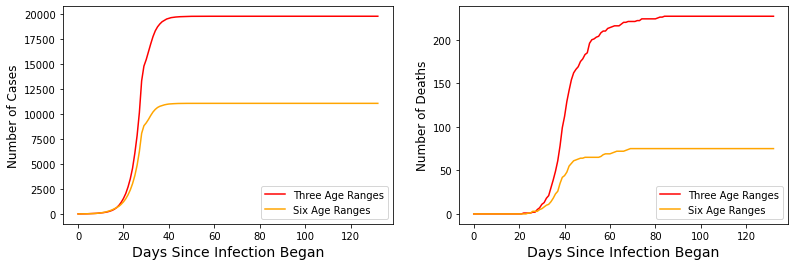

In [17]:
x1 = range(len(bristol_df_timeseries))

plt.figure()
# plt.xlim([0,150])
# plt.ylim([0,300])

# deaths
plt.subplot(121)
plt.plot(x1, bristol_df_timeseries['total_infected'], 'red', x1, mdm_df_timeseries['total_infected'], 'orange')
plt.legend(["Three Age Ranges", "Six Age Ranges"])
plt.xlabel("Days Since Infection Began", size = 14)
plt.ylabel("Number of Cases", size = 12)

# cases (x3, bristol_deaths['Total'], '#0072B2',)
plt.subplot(122)
plt.plot( x1, bristol_df_timeseries['n_death'], 'red', x1, mdm_df_timeseries['n_death'], 'orange')
plt.legend(["Three Age Ranges", "Six Age Ranges"])
plt.xlabel("Days Since Infection Began", size = 14)
plt.ylabel("Number of Deaths", size = 12)

plt.rcParams["figure.figsize"] = (16,4)

plt.show()


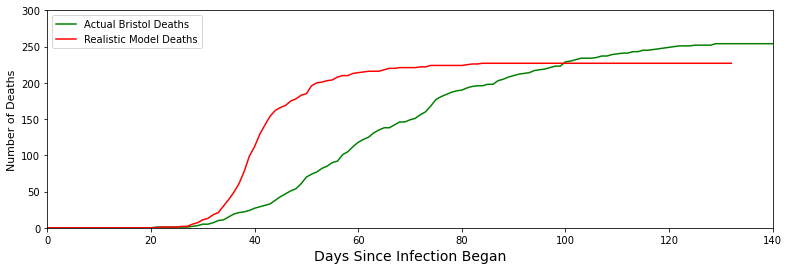

In [24]:
x1 = range(len(bristol_df_timeseries))
x2 = range(len(mdm_df_timeseries))

bristol_deaths = pd.read_csv(join("../../bristol_msoa_deaths.csv"))
x3 = range(len(bristol_deaths))


plt.figure()
plt.xlim([0, 140])
plt.ylim([0, 300])
# # cases
# plt.subplot(121)
# plt.plot(x1, bristol_df_timeseries['total_infected'], 'red', x2, mdm_df_timeseries['total_infected'], 'orange')
# plt.legend(["Bristol Cases", "Modeled Cases"])

# # deaths
# plt.subplot(122)
plt.plot(x3, bristol_deaths['Total'], 'green', x1, bristol_df_timeseries['n_death'], 'red')
plt.xlabel("Days Since Infection Began", size = 14)
plt.ylabel("Number of Deaths", size = 11)
plt.legend(["Actual Bristol Deaths", "Realistic Model Deaths"], loc='upper left')
plt.rcParams["figure.figsize"] = (13,4)
plt.show()

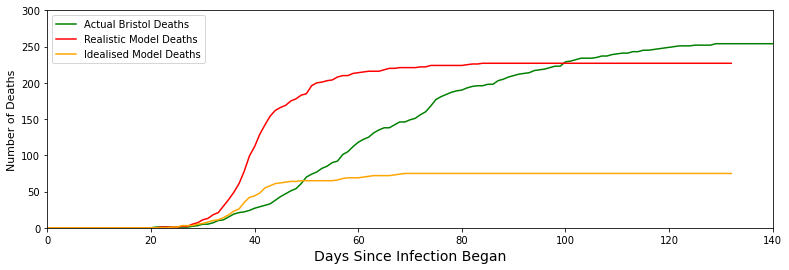

In [25]:
x1 = range(len(bristol_df_timeseries))
x2 = range(len(mdm_df_timeseries))

bristol_deaths = pd.read_csv(join("../../bristol_msoa_deaths.csv"))
x3 = range(len(bristol_deaths))

bristol_cases = pd.read_csv(join("../../bristol_msoa_cases.csv"))
x4 = range(len(bristol_cases))

plt.figure()
plt.xlim([0, 140])
plt.ylim([0, 300])
# # cases
# plt.subplot(121)
# plt.plot(x1, bristol_df_timeseries['total_infected'], 'red', x2, mdm_df_timeseries['total_infected'], 'orange')
# plt.legend(["Bristol Cases", "Modeled Cases"])

# # deaths
# plt.subplot(122)
plt.plot(x3, bristol_deaths['Total'], 'green', x1, bristol_df_timeseries['n_death'], 'red', x2, mdm_df_timeseries['n_death'], 'orange')
plt.xlabel("Days Since Infection Began", size = 14)
plt.ylabel("Number of Deaths", size = 11)
plt.legend(["Actual Bristol Deaths", "Realistic Model Deaths", "Idealised Model Deaths"])
plt.rcParams["figure.figsize"] = (13,4)
plt.show()

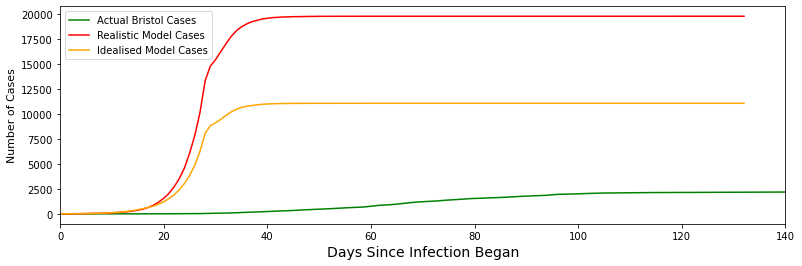

In [26]:
x1 = range(len(bristol_df_timeseries))
x2 = range(len(mdm_df_timeseries))

bristol_deaths = pd.read_csv(join("../../bristol_msoa_deaths.csv"))
x3 = range(len(bristol_deaths))

bristol_cases = pd.read_csv(join("../../bristol_msoa_cases.csv"))
x4 = range(len(bristol_cases))

plt.figure()
plt.xlim([0, 140])
# plt.ylim([0, 300])
# # cases
# plt.subplot(121)
# plt.plot(x1, bristol_df_timeseries['total_infected'], 'red', x2, mdm_df_timeseries['total_infected'], 'orange')
# plt.legend(["Bristol Cases", "Modeled Cases"])

# # deaths
# plt.subplot(122)
plt.plot(x4, bristol_cases['CASES'], 'green', x1, bristol_df_timeseries['total_infected'], 'red', x2, mdm_df_timeseries['total_infected'], 'orange')
plt.xlabel("Days Since Infection Began", size = 14)
plt.ylabel("Number of Cases", size = 11)
plt.legend(["Actual Bristol Cases", "Realistic Model Cases", "Idealised Model Cases"])
plt.rcParams["figure.figsize"] = (13,4)
plt.show()

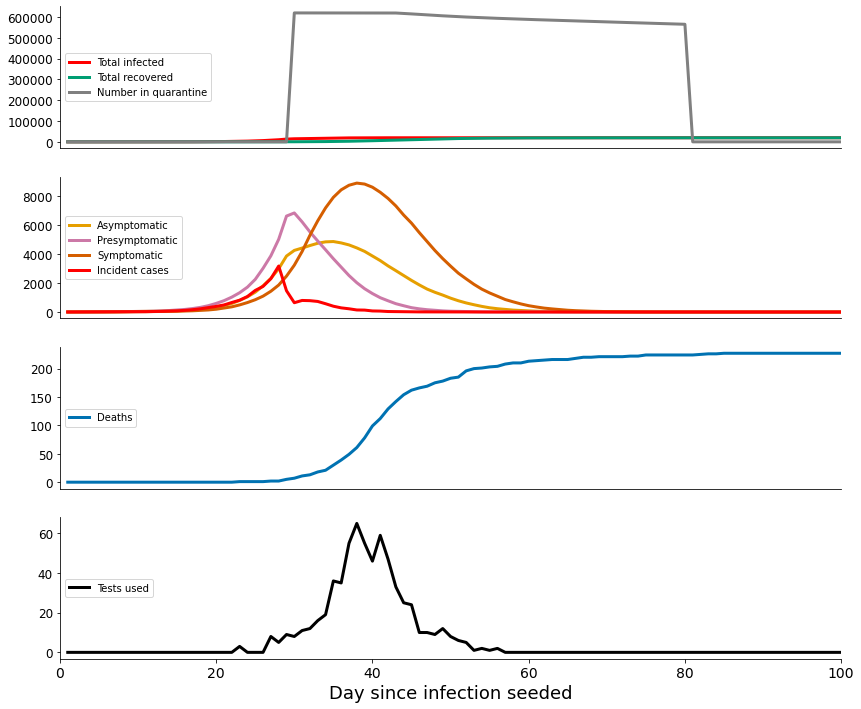

In [117]:
# bristol scenario time series plot
plt.rcParams['figure.figsize'] = [14, 12]
fig, ax = plotting.plot_timeseries_curves(bristol_df_timeseries, xlimits = [0, 100])

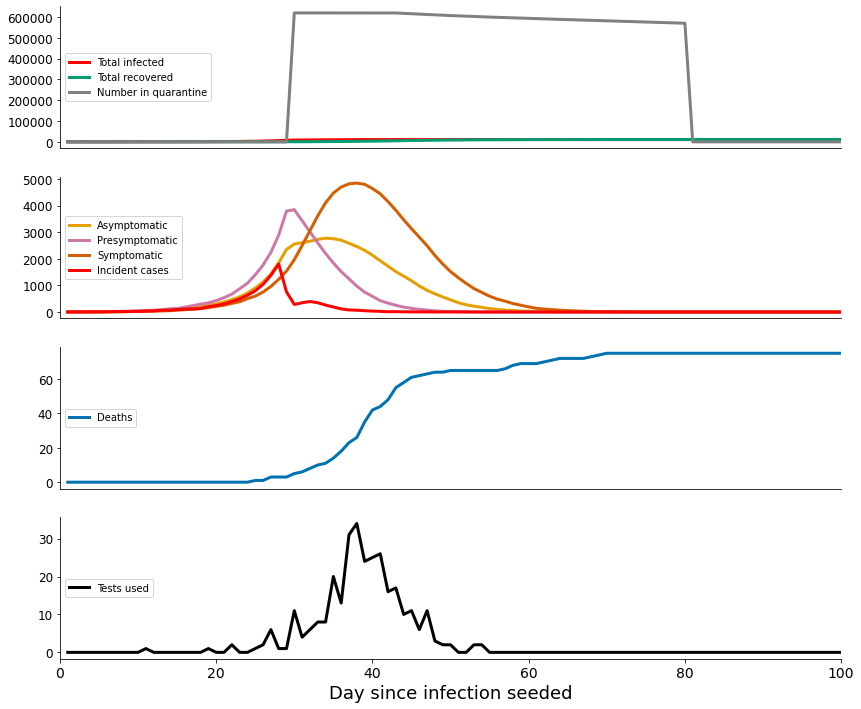

In [140]:
# mdm scenario time series plot
plt.rcParams['figure.figsize'] = [14, 12]
fig, ax = plotting.plot_timeseries_curves(mdm_df_timeseries, xlimits = [0, 100])

# Network type comparison <a class="anchor"></a>
Plot the epidemic trajectory and other outputs from the time series file for a single parameter set.  

In [23]:
from COVID19.model import AgeGroupEnum, EVENT_TYPES, TransmissionTypeEnum, OccupationNetworkEnum

interaction_types = [c.value for c in TransmissionTypeEnum ]
interaction_labels = [c.name[1:].title() for c in TransmissionTypeEnum]

occupation_types = [c.value for c in OccupationNetworkEnum ]
occupation_labels = [c.name[1:].title().replace("_", " ") for c in OccupationNetworkEnum ]

AGE_OCCUPATION_MAP = [
    OccupationNetworkEnum._primary_network.value,
    OccupationNetworkEnum._secondary_network.value,
    OccupationNetworkEnum._working_network.value,
    OccupationNetworkEnum._working_network.value,
    OccupationNetworkEnum._working_network.value,
    OccupationNetworkEnum._working_network.value,
    OccupationNetworkEnum._working_network.value,
    OccupationNetworkEnum._retired_network.value,
    OccupationNetworkEnum._elderly_network.value]

infectious_compartments = ["PRESYMPTOMATIC", "PRESYMPTOMATIC_MILD", "ASYMPTOMATIC", "SYMPTOMATIC", "SYMPTOMATIC_MILD"]
infectious_types = [e.value for e in EVENT_TYPES if e.name in infectious_compartments]
infectious_names = [e.name for e in EVENT_TYPES if e.name in infectious_compartments]
infectious_labels = [plotting.EVENT_TYPE_STRING[e.value] for e in EVENT_TYPES if e.name in infectious_compartments]

# Define age groups and labels <- FIXME: change to Enum in constant.py
n_age = len(AgeGroupEnum) + 1
age_group_labels = [enum.name[1:].replace("_","-") for enum in AgeGroupEnum]
age_group_labels[-1] = "80+"

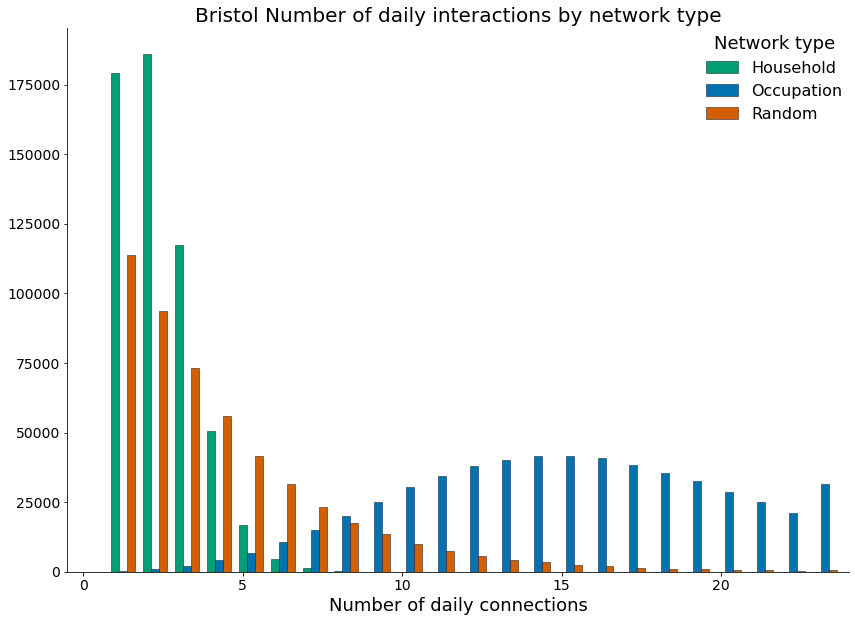

In [39]:
plt.rcParams['figure.figsize'] = [14, 10]
# Count interactions for each individual by "type" of interaction
df_agg = bristol_df_interact.groupby(["ID_1", "type"])["ID_1"].count().reset_index(name = "count")

# Plot histogram of interaction by network type
fig, ax = plotting.plot_hist_by_group(df_agg, groupvar = "type", binvar = "count", 
    groups = interaction_types, bins = 25, group_colours = plotting.network_colours, 
    group_labels = interaction_labels, 
    xlabel = "Number of daily connections", 
    title = "Bristol Number of daily interactions by network type", 
    legend_title = "Network type")

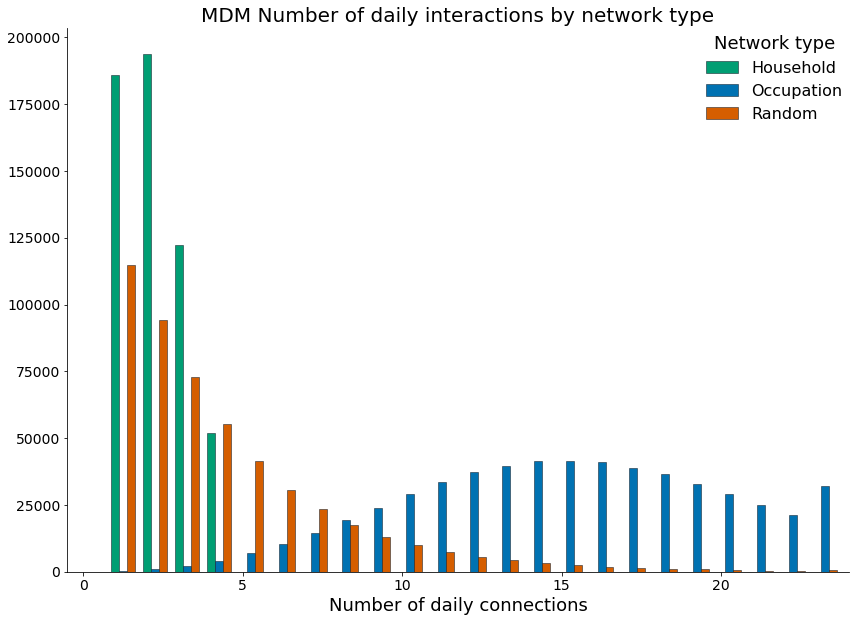

In [40]:
plt.rcParams['figure.figsize'] = [14, 10]
# Count interactions for each individual by "type" of interaction
df_agg = mdm_df_interact.groupby(["ID_1", "type"])["ID_1"].count().reset_index(name = "count")

# Plot histogram of interaction by network type
fig, ax = plotting.plot_hist_by_group(df_agg, groupvar = "type", binvar = "count", 
    groups = interaction_types, bins = 25, group_colours = plotting.network_colours, 
    group_labels = interaction_labels, 
    xlabel = "Number of daily connections", 
    title = "MDM Number of daily interactions by network type", 
    legend_title = "Network type")

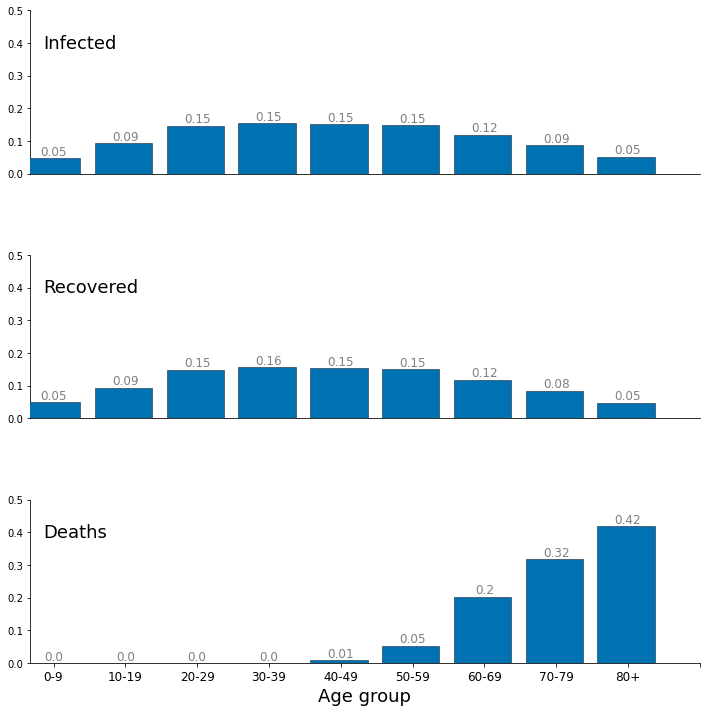

In [41]:
plt.rcParams['figure.figsize'] = [12, 12]
groupvars = ["time_infected", "time_recovered", "time_death"]
labels = ["Infected", "Recovered", "Deaths"]
fig, ax = plotting.PlotHistByAge(bristol_df_trans, groupvars = groupvars, group_labels = labels,
    NBINS = n_age -1 , density = True, xticklabels = age_group_labels, xlabel = "Age group",
    ylim = 0.5, age_group_var = "age_group_recipient")

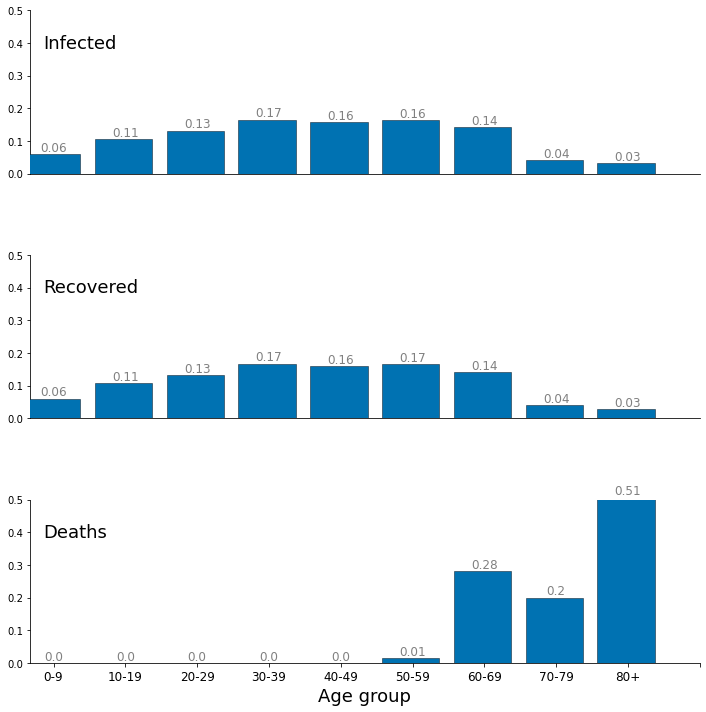

In [42]:
plt.rcParams['figure.figsize'] = [12, 12]
groupvars = ["time_infected", "time_recovered", "time_death"]
labels = ["Infected", "Recovered", "Deaths"]
fig, ax = plotting.PlotHistByAge(mdm_df_trans, groupvars = groupvars, group_labels = labels,
    NBINS = n_age -1 , density = True, xticklabels = age_group_labels, xlabel = "Age group",
    ylim = 0.5, age_group_var = "age_group_recipient")

/home/linuxbrew/.linuxbrew/opt/python@3.9/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3208: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return asarray(a).size
/home/linuxbrew/.linuxbrew/opt/python@3.9/lib/python3.9/site-packages/matplotlib/cbook/__init__.py:1376: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  X = np.atleast_1d(X.T if isinstance(X, np.ndarray) else np.asarray(X))


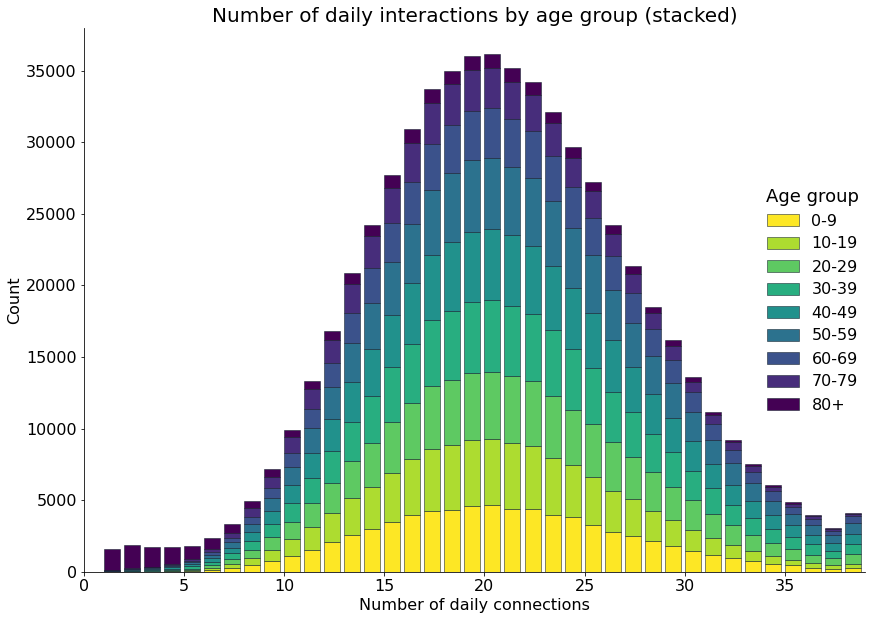

In [24]:
plt.rcParams['figure.figsize'] = [14, 10]
fig, ax = plotting.plot_interactions_by_age(
    bristol_df_interact, groupvar = "age_group_1", 
    group_labels = age_group_labels, legend_title = "Age group", 
    title = "Number of daily interactions by age group (stacked)", 
    xlabel = "Number of daily connections", ylabel = "Count")

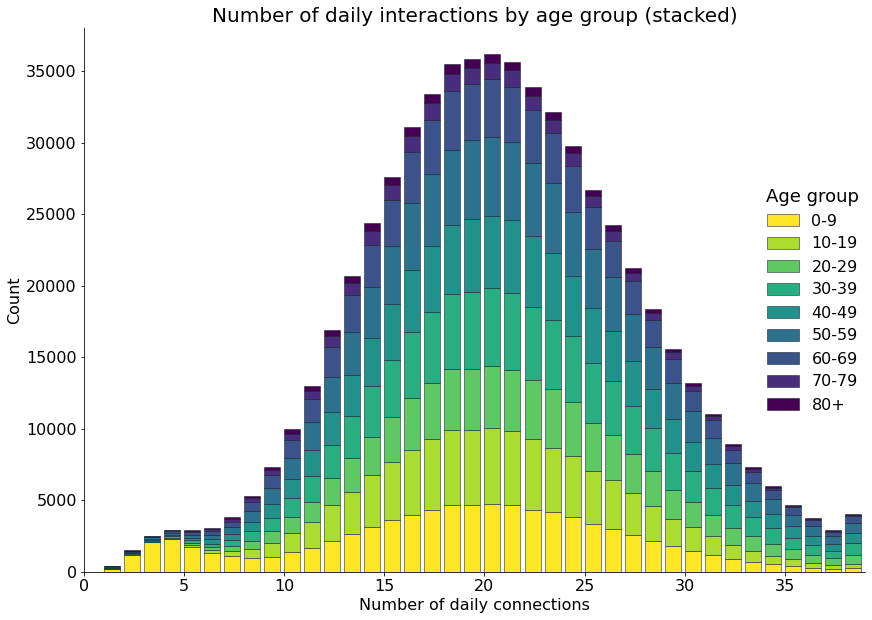

In [25]:
plt.rcParams['figure.figsize'] = [14, 10]
fig, ax = plotting.plot_interactions_by_age(
    mdm_df_interact, groupvar = "age_group_1", 
    group_labels = age_group_labels, legend_title = "Age group", 
    title = "Number of daily interactions by age group (stacked)", 
    xlabel = "Number of daily connections", ylabel = "Count")

In [26]:
interactions = pd.pivot_table(bristol_df_interact, index = "age_group_1", columns = "type", aggfunc = 'size', fill_value = 0)
interactions.columns = interaction_labels
interactions["Age group"] = age_group_labels
display(interactions[["Age group"] + interaction_labels].style.hide_index())

Age group,Household,Occupation,Random
0-9,209415,1148673,146415
10-19,208574,1149667,144920
20-29,156255,1280641,329754
30-39,164963,1356499,345306
40-49,164083,1346554,344612
50-59,163798,1345956,345121
60-69,93402,937457,241142
70-79,44271,735868,140099
80+,24283,262257,77435


In [27]:
interactions = pd.pivot_table(mdm_df_interact, index = "age_group_1", columns = "type", aggfunc = 'size', fill_value = 0)
interactions.columns = interaction_labels
interactions["Age group"] = age_group_labels
display(interactions[["Age group"] + interaction_labels].style.hide_index())

Age group,Household,Occupation,Random
0-9,224618,1187588,168155
10-19,223543,1333926,168859
20-29,136160,1178840,299271
30-39,170798,1453889,373189
40-49,152127,1377234,350839
50-59,152031,1462838,373167
60-69,73671,1080286,273578
70-79,10148,330619,61184
80+,5658,188378,34622


In [31]:
transmissions = pd.pivot_table(bristol_df_trans, 
    index = "age_group_recipient", columns = "infector_network", 
    aggfunc = 'size', fill_value = 0)
transmissions.columns = interaction_labels
transmissions["Age group"] = age_group_labels
display(transmissions[["Age group"] + interaction_labels].style.hide_index().set_properties(subset=["Age group"], **{'font-weight': 'bold'}))

Age group,Household,Occupation,Random
0-9,712,103,127
10-19,1105,534,188
20-29,950,1247,701
30-39,1000,1279,771
40-49,969,1307,721
50-59,935,1287,724
60-69,667,1076,606
70-79,453,837,425
80+,243,528,252


In [30]:
transmissions = pd.pivot_table(mdm_df_trans, 
    index = "age_group_recipient", columns = "infector_network", 
    aggfunc = 'size', fill_value = 0)
transmissions.columns = interaction_labels
transmissions["Age group"] = age_group_labels
display(transmissions[["Age group"] + interaction_labels].style.hide_index().set_properties(subset=["Age group"], **{'font-weight': 'bold'}))

Age group,Household,Occupation,Random
0-9,474,110,71
10-19,719,311,145
20-29,347,712,391
30-39,439,932,460
40-49,418,892,434
50-59,472,922,428
60-69,357,803,419
70-79,52,287,113
80+,23,246,74


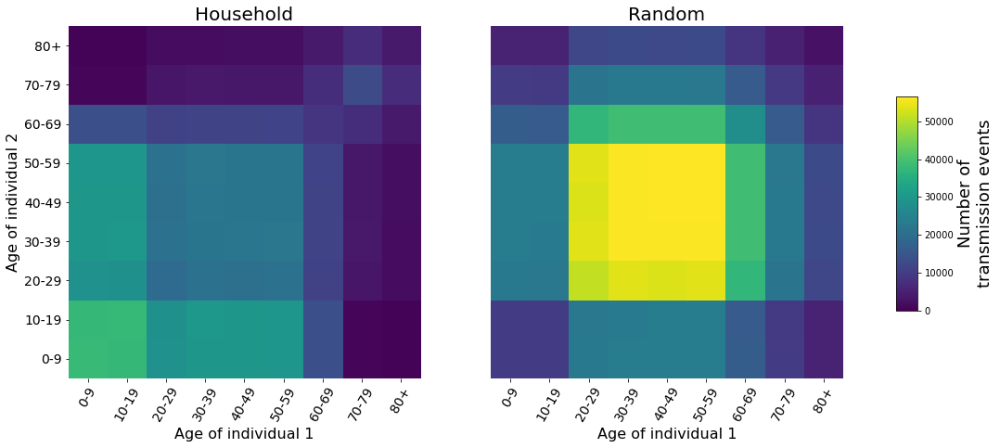

In [28]:
interaction_types_not_occ = [c.value for c in TransmissionTypeEnum if c.name in ["_household", "_random"]]
interaction_labels_not_occ = [c.name[1:].title() for c in TransmissionTypeEnum if c.name in ["_household", "_random"]]

plt.rcParams['figure.figsize'] = [16, 8]
fig, ax = plotting.transmission_heatmap_by_age_by_panels(
    bristol_df_interact, "age_group_1", "age_group_2", bins = n_age, 
    panels = interaction_types_not_occ,
    panelvar = "type", panel_labels = interaction_labels_not_occ,
    xlabel = "Age of individual 1", ylabel = "Age of individual 2", 
    legend_title = "Number of\ntransmission events",
    xticklabels = age_group_labels, yticklabels = age_group_labels)

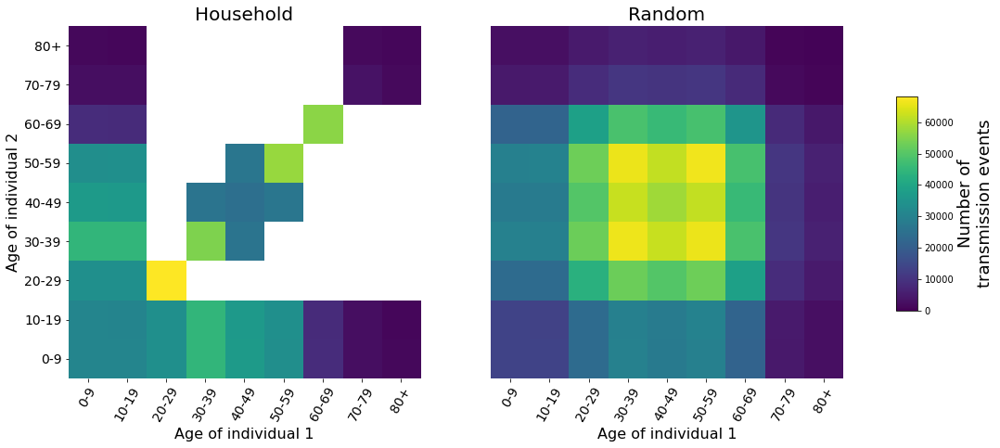

In [29]:
interaction_types_not_occ = [c.value for c in TransmissionTypeEnum if c.name in ["_household", "_random"]]
interaction_labels_not_occ = [c.name[1:].title() for c in TransmissionTypeEnum if c.name in ["_household", "_random"]]

plt.rcParams['figure.figsize'] = [16, 8]
fig, ax = plotting.transmission_heatmap_by_age_by_panels(
    mdm_df_interact, "age_group_1", "age_group_2", bins = n_age, 
    panels = interaction_types_not_occ,
    panelvar = "type", panel_labels = interaction_labels_not_occ,
    xlabel = "Age of individual 1", ylabel = "Age of individual 2", 
    legend_title = "Number of\ntransmission events",
    xticklabels = age_group_labels, yticklabels = age_group_labels)

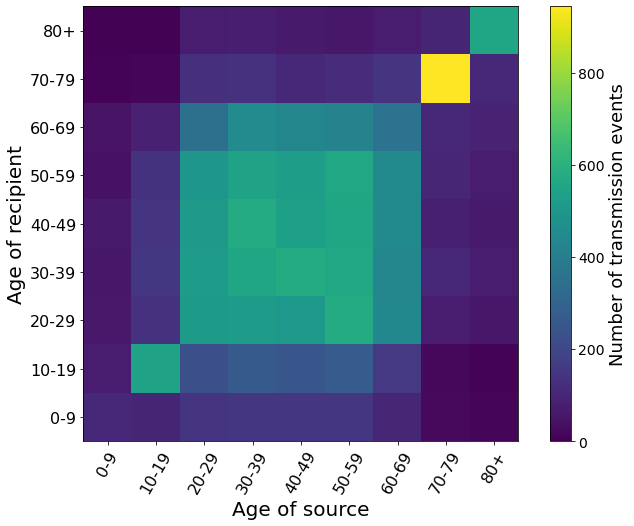

In [32]:
plt.rcParams['figure.figsize'] = [14, 8]

display(HTML("Of all transmission events, the following figure shows the distribution of transmission events (2D histogram)<br> stratified by the age of the source and recipient."))

fig, ax = plotting.plot_transmission_heatmap_by_age(bristol_df_trans, "age_group_recipient", "age_group_source", 
    bins = n_age, xlabel = "Age of source", ylabel = "Age of recipient", 
    legend_title = "Number of transmission events",
    xticklabels = age_group_labels, yticklabels = age_group_labels)

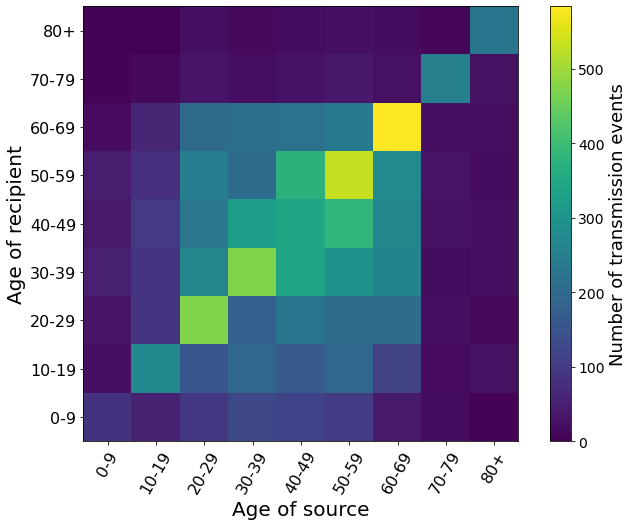

In [33]:
plt.rcParams['figure.figsize'] = [14, 8]

display(HTML("Of all transmission events, the following figure shows the distribution of transmission events (2D histogram)<br> stratified by the age of the source and recipient."))

fig, ax = plotting.plot_transmission_heatmap_by_age(mdm_df_trans, "age_group_recipient", "age_group_source", 
    bins = n_age, xlabel = "Age of source", ylabel = "Age of recipient", 
    legend_title = "Number of transmission events",
    xticklabels = age_group_labels, yticklabels = age_group_labels)

# GIS Plots

In [ ]:
iow_path = '../../id_spatial_sim/scenarios/mdm3_scenario/output/networks'
model_iow = ImperialNetwork(iow_path)
iow_msoa = pd.read_csv('../../id_spatial_sim/scenarios/mdm3_scenario/msoaLists/bristol_msoa.csv')

In [51]:
msoaShapefilesPath = '../../id_spatial_sim/data/msoa_shapefile/Middle_Layer_Super_Output_Areas_(December_2011)_Boundaries.shp'
msoaShapefiles = gpd.read_file(msoaShapefilesPath)

In [52]:
polygons = [msoaShapefiles.loc[msoaShapefiles['msoa11cd']==x]['geometry'] for x in list(iow_msoa['msoa11cd'])]

NameError: name 'iow_msoa' is not defined

In [ ]:
# Combine and plot the shapefiles for overlapping area
sf_iow = polygons[0]
for i in range(len(polygons)):
    sf_iow = sf_iow.union(polygons[i],align=False)
sf_iow = sf_iow.to_crs("WGS84") #d weird GIS projectoins
# sf_iow.plot()

In [49]:
def IndividualSeries(model):
    return gpd.GeoSeries([Point(coord2ll_listIn(x)) for x in np.array(model.get_individuals()[['xcoords','ycoords']])])

In [50]:
def InfectedSeries(model):
    I = Infected(model)
    X = [Point(coord2ll_listIn(x[1:])) for x in np.array(model.get_individuals()[['ID','xcoords','ycoords']]) if x[0] in I]
    return gpd.GeoSeries(X)

/home/linuxbrew/.linuxbrew/opt/python@3.9/lib/python3.9/site-packages/geoplot/geoplot.py:1724: UserWarning: "webmap" is only compatible with the "WebMercator" projection, but the input projection is unspecified. Reprojecting the data to "WebMercator" automatically. To suppress this warning, set "projection=gcrs.WebMercator()" explicitly.
  warnings.warn(


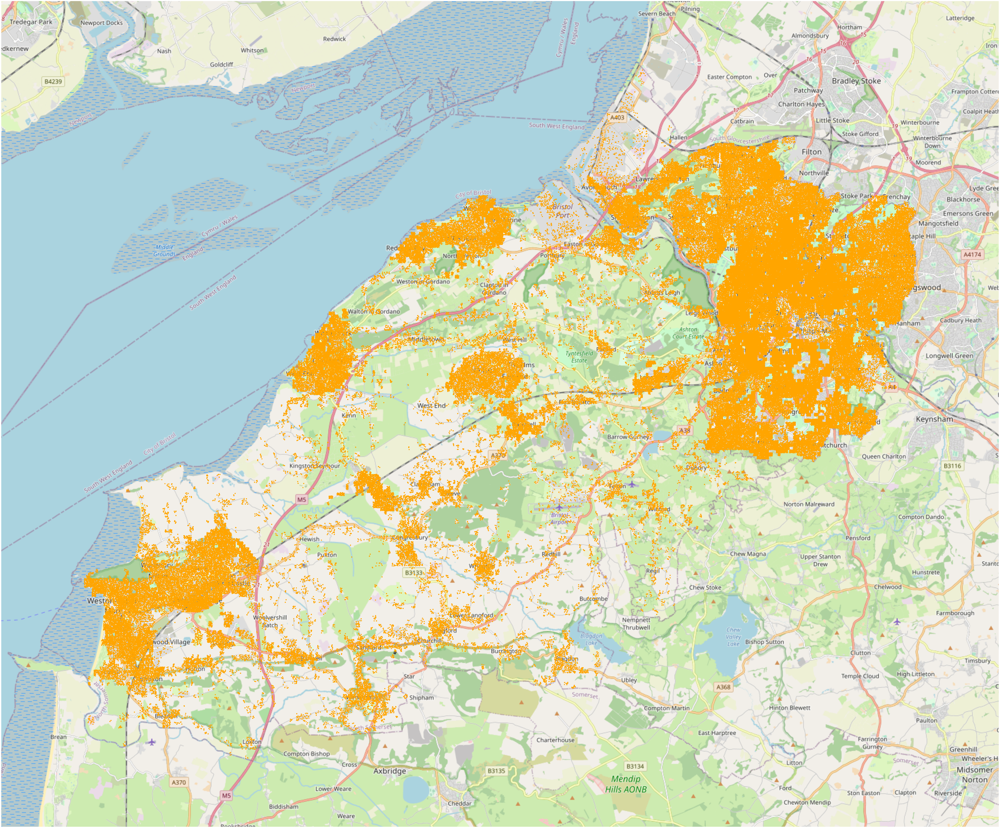

In [53]:
X = IndividualSeries(bristol_model)
projection=gcrs.WebMercator()
ax = gplt.webmap(X,figsize=(100,85))
gplt.pointplot(X,ax=ax,color='orange',  legend=True)

/home/linuxbrew/.linuxbrew/opt/python@3.9/lib/python3.9/site-packages/geoplot/geoplot.py:1724: UserWarning: "webmap" is only compatible with the "WebMercator" projection, but the input projection is unspecified. Reprojecting the data to "WebMercator" automatically. To suppress this warning, set "projection=gcrs.WebMercator()" explicitly.
  warnings.warn(


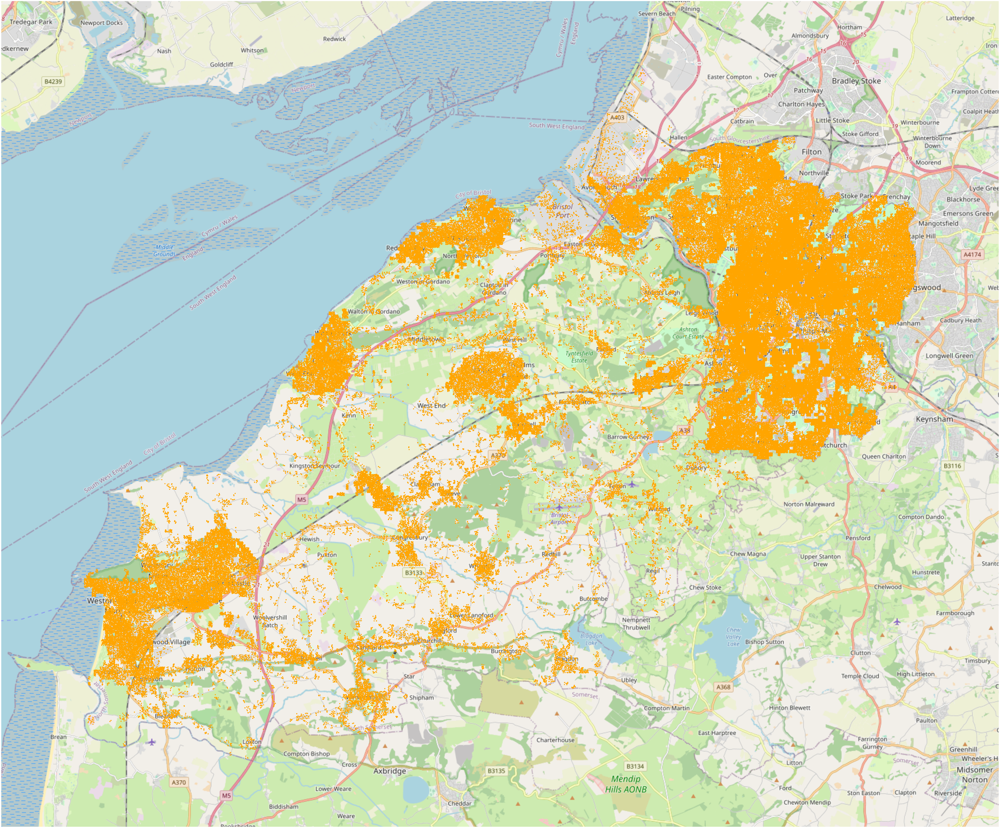

In [54]:
X1 = IndividualSeries(mdm_model)
projection=gcrs.WebMercator()
ax = gplt.webmap(X1,figsize=(100,85))
gplt.pointplot(X,ax=ax,color='orange')

In [ ]:
# Infect and run
for i in range(10):
    model_iow.new_infection_by_idx(i,0,0,0)
for i in tqdm(range(16)):
    model_iow.one_time_step()
# model_iow.one_time_step_results()

In [ ]:
# Hip kinda heatmap of infected overlayed on actual map
# Takes a while
X = IndividualSeries(model_iow)
ax = gplt.webmap(X,figsize=(100,100))
gplt.kdeplot(InfectedSeries(model_iow),shade=True, cmap='Reds',alpha=0.25,ax=ax)
gplt.kdeplot(X,shade=True,alpha=0.0,ax=ax,clip=sf_iow) #d a hacky way to not 'zoom' into to only the area infected are

In [ ]:
def VisualiseNetwork_WithMap(model, ax, aNode = 1/2**7, aEdge = 1/2**7):
    nodes = model.get_individuals()
    nodes_pos = {nodes['ID'][i]:[nodes['xcoords'][i],nodes['ycoords'][i]] for i in range(len(nodes))}
    infected = Infected(model)
    quarantined = Lockdowned(model)
    g = nx.Graph()
    #g = nx.from_pandas_edgelist(ocNetworksArcs_df_dict['primary'],'ID_1','ID_2',create_using=nx.Graph())
    g.add_nodes_from(nodes['ID'])
    g_infected = nx.subgraph(g,infected)
    g_quarantined = nx.subgraph(g,quarantined)
    #f,ax = plt.subplots(figsize=(20,10))
    ax = gplt.webmap(X,figsize=(20,10))
    nx.draw(g,pos=nodes_pos,node_size=5,edge_color=AddTransparency(hadeanOrange,aEdge),node_color=AddTransparency(hadeanIndigo,aNode),ax=ax)
    nx.draw_networkx_nodes(g_quarantined,pos=nodes_pos,node_size=5,node_color=AddTransparency(uranianBlue,0.02),ax=ax)
    nx.draw_networkx_nodes(g_infected,pos=nodes_pos,node_size=5,node_color=AddTransparency(hadeanOrange,0.9),ax=ax)
    
    gplt.pointplot(X,ax=ax,color='orange')

In [ ]:
# Run several time-steps and produce many PNGs to be converted to a GIF
def RunSim_WithMap(model, out_dir=gif_out, n=64, title_text='Spread of COVID-19 on an artificial network of Bristol'):
    for i in tqdm(range(n)):
        f,ax = plt.subplots(figsize=(20,10))
        t = model.one_time_step_results()['time']        
        VisualiseNetwork(model,ax)
        plt.title(title_text,fontsize=32)
        agentPatch = Line2D([0],[0],marker='o',linestyle='none',color=AddTransparency(hadeanIndigo,aNode),label='Agent')
        conPatch = Line2D([0],[0],marker='o',linestyle='none',color=AddTransparency(hadeanOrange,0.9),label='Contagious')
        lg1 = plt.legend(handles=[agentPatch,conPatch],fontsize=16)
        text = "Time = "+"{:04d}".format(t)
        textPatch = Line2D([0],[0],linestyle='none',label=text)
        ax.legend(handles=[textPatch],loc='lower left',frameon=False)
        ax.add_artist(lg1)
        print(out_dir+"{:04d}".format(t)+'.png')
        f.savefig(out_dir+"{:04d}".format(t)+'.png')
        model.one_time_step()
        ax.clear()
        plt.clf()